In [ ]:
!pip install sumolib


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 150.9/150.9 kB 2.7 MB/s eta 0:00:00


In [ ]:
!python main.py
from google.colab import files

files.download("traffic_data.csv")  # Replace with your actual file name


 Retrying in 1 seconds
Step #86695.00 (1ms ~= 1000.00*RT, ~0.00UPS, TraCI: 3ms, vehicles TOT 86400 ACT 0 BUF 0)  


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
!apt-get update
!apt-get install -y sumo sumo-tools sumo-doc


Get:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]
Get:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1,581 B]
Get:3 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages [1,369 kB]
Get:4 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Hit:5 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:6 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Get:7 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Get:8 https://r2u.stat.illinois.edu/ubuntu jammy/main all Packages [8,723 kB]
Hit:9 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:10 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Hit:11 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Get:12 http://security.ubuntu.com/ubuntu jammy-security/restricted amd64 Packages [3,774 kB]
Get:13 http://archive.ubuntu.com

In [ ]:
!which sumo


/usr/bin/sumo


In [ ]:
import os
os.environ["SUMO_HOME"] = "/usr/share/sumo"
!pip install traci

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 126.4/126.4 kB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 150.9/150.9 kB 7.1 MB/s eta 0:00:00


In [ ]:
import traci
import math
import csv

# Take user input for GUI mode
gui_mode = input("Enter 1 for SUMO GUI, 0 for non-GUI: ").strip()
sumo_binary = '/usr/bin/sumo'

# Start SUMO
traci.start([sumo_binary, "-c", "test.sumocfg"])

# Define junctions and their IDs
junctions = ['A', 'B', 'C', 'D', 'E']
junction_positions = {j: traci.junction.getPosition(j) for j in junctions}

# Define all 12 roads (edges) for velocity tracking
roads = ['AB', 'AC', 'AD', 'BA', 'BC', 'BE', 'CA', 'CB', 'CD', 'CE', 'DA', 'DC', 'DE', 'EB', 'EC', 'ED']

# Define the distance threshold (in meters) for vehicle counting at junctions
distance_threshold = 20.0

# Function to draw a translucent blue circle around junctions
def draw_circle(junction_id, position, radius, color):
    points = [
        (position[0] + radius * math.cos(angle), position[1] + radius * math.sin(angle))
        for angle in [i * (math.pi / 10) for i in range(21)]
    ]
    traci.polygon.add(junction_id, points, color, fill=True, layer=0)

# Only add visualizations if GUI mode is enabled
if gui_mode == "1":
    circle_color = (0, 0, 255, 100)  # Blue with transparency
    for junction in junctions:
        draw_circle(f"circle_{junction}", junction_positions[junction], distance_threshold, circle_color)

# Set simulation scale to 0.5 (half-speed) for consistency
traci.simulation.setScale(0.5)

# Open a CSV file to store time-series data
with open("traffic_data.csv", "w", newline="") as csvfile:
    fieldnames = ["Time"] + [f"Vehicle Count at Junction {j}" for j in junctions] + \
                 [f"Avg Speed on {r}" for r in roads]
    writer = csv.DictWriter(csvfile, fieldnames=fieldnames)
    writer.writeheader()

    # Simulation loop
    while traci.simulation.getMinExpectedNumber() > 0:
        traci.simulationStep()

        # Initialize data dictionary
        time_step = traci.simulation.getTime()
        data = {"Time": time_step}

        # Count vehicles at each junction
        for junction in junctions:
            count = 0
            for vehicle in traci.vehicle.getIDList():
                vehicle_position = traci.vehicle.getPosition(vehicle)
                junction_position = junction_positions[junction]

                # Calculate Euclidean distance
                distance = math.sqrt((vehicle_position[0] - junction_position[0])**2 +
                                     (vehicle_position[1] - junction_position[1])**2)

                if distance <= distance_threshold:
                    count += 1

            data[f"Vehicle Count at Junction {junction}"] = count

        # Calculate average speed on each road
        for road in roads:
            vehicle_ids = traci.edge.getLastStepVehicleIDs(road)
            avg_speed = sum(traci.vehicle.getSpeed(v) for v in vehicle_ids) / len(vehicle_ids) if vehicle_ids else 0
            data[f"Avg Speed on {road}"] = avg_speed

        # Write data to CSV
        writer.writerow(data)

traci.close()


In [4]:
import traci
import math
import csv

# Take user input for GUI mode
gui_mode = 0
sumo_binary = "/usr/bin/sumo" #if gui_mode == "1" else "sumo"

# Start SUMO
traci.start([sumo_binary, "-c", "test.sumocfg"])

# Define junctions and their IDs
junctions = ['A', 'B', 'C', 'D', 'E']
junction_positions = {j: traci.junction.getPosition(j) for j in junctions}

# Define roads (edges) for velocity tracking
roads = ['AB', 'BC', 'CA', 'CD', 'ED', 'DA']

# Define the distance threshold (in meters) for vehicle counting at junctions
distance_threshold = 20.0

# Function to draw a translucent blue circle around junctions
def draw_circle(junction_id, position, radius, color):
    points = [
        (position[0] + radius * math.cos(angle), position[1] + radius * math.sin(angle))
        for angle in [i * (math.pi / 10) for i in range(21)]
    ]
    traci.polygon.add(junction_id, points, color, fill=True, layer=0)

# Function to set traffic scale based on time of day
def update_traffic_scale(time_step):
    hour = (time_step // 3600) % 24  # Convert simulation time (seconds) to hours

    if 0 <= hour < 4:
        traci.simulation.setScale(0.1)
    elif 4 <= hour < 7:
        traci.simulation.setScale(0.2)
    elif 7 <= hour < 12:
        traci.simulation.setScale(0.4)
    elif 12 <= hour < 15:
        traci.simulation.setScale(0.7)
    elif 15 <= hour < 19:
        traci.simulation.setScale(0.2)
    elif 19 <= hour < 22:
        traci.simulation.setScale(0.4)
    elif 22 <= hour < 24:
        traci.simulation.setScale(0.2)

# Only add visualizations if GUI mode is enabled
if gui_mode == "1":
    circle_color = (0, 0, 255, 100)  # Blue with transparency
    for junction in junctions:
        draw_circle(f"circle_{junction}", junction_positions[junction], distance_threshold, circle_color)

# Set simulation scale to 0.5 (constant)
#traci.simulation.setScale(0.5)

# Open a CSV file to store time-series data
with open("traffic_data_dyn.csv", "w", newline="") as csvfile:
    fieldnames = ["Time"] + [f"Vehicle Count at Junction {j}" for j in junctions] + \
                 [f"Avg Speed on {r}" for r in roads]
    writer = csv.DictWriter(csvfile, fieldnames=fieldnames)
    writer.writeheader()

    # Simulation loop
    while traci.simulation.getMinExpectedNumber() > 0:
        traci.simulationStep()

        # Update traffic scale dynamically
        update_traffic_scale(traci.simulation.getTime())

        # Initialize data dictionary
        time_step = traci.simulation.getTime()
        data = {"Time": time_step}

        # Count vehicles at each junction
        for junction in junctions:
            count = 0
            for vehicle in traci.vehicle.getIDList():
                vehicle_position = traci.vehicle.getPosition(vehicle)
                junction_position = junction_positions[junction]

                # Calculate Euclidean distance
                distance = math.sqrt((vehicle_position[0] - junction_position[0])**2 +
                                     (vehicle_position[1] - junction_position[1])**2)

                if distance <= distance_threshold:
                    count += 1

            data[f"Vehicle Count at Junction {junction}"] = count

        # Calculate average speed on each road
        for road in roads:
            vehicle_ids = traci.edge.getLastStepVehicleIDs(road)
            avg_speed = sum(traci.vehicle.getSpeed(v) for v in vehicle_ids) / len(vehicle_ids) if vehicle_ids else 0
            data[f"Avg Speed on {road}"] = avg_speed

        # Write data to CSV
        writer.writerow(data)

traci.close()


 Retrying in 1 seconds


In [ ]:
from google.colab import files

files.download("/content/traffic_data.csv")  # Replace with your actual file name


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
!kill -9 $(pgrep python)


In [ ]:
traci.close

<function traci.main.close(wait=True)>

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

file = "/content/traffic_data.csv"
data= pd.read_csv(file)

data.head()

,Time,Vehicle Count at Junction A,Vehicle Count at Junction B,Vehicle Count at Junction C,Vehicle Count at Junction D,Vehicle Count at Junction E,Avg Speed on AB,Avg Speed on AC,Avg Speed on AD,Avg Speed on BA,...,Avg Speed on CA,Avg Speed on CB,Avg Speed on CD,Avg Speed on CE,Avg Speed on DA,Avg Speed on DC,Avg Speed on DE,Avg Speed on EB,Avg Speed on EC,Avg Speed on ED
0,1.0,0,0,0,0,0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.00000,0.0
1,2.0,0,0,0,0,0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.317469,0.000000,0.0,0.0,0.00000,0.0
2,3.0,0,0,0,0,0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,3.199004,0.000000,0.0,0.0,0.00000,0.0
3,4.0,0,0,0,0,0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,5.222676,1.384303,0.0,0.0,0.00000,0.0
4,5.0,0,0,0,0,0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,6.901379,3.065587,0.0,0.0,1.66596,0.0


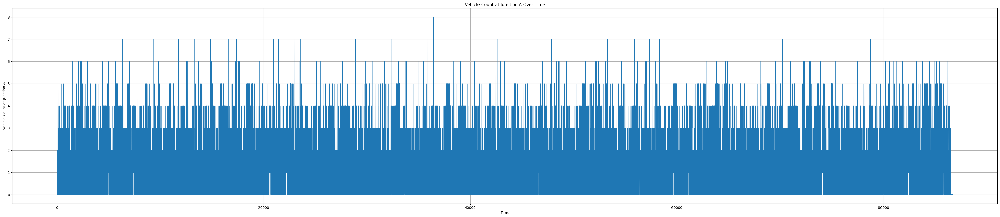

In [ ]:
plt.figure(figsize=(50,10))
plt.plot(data["Vehicle Count at Junction A"])

# Add labels and title
plt.xlabel("Time")
plt.ylabel("Vehicle Count at Junction A")
plt.title("Vehicle Count at Junction A Over Time")

# Show the grid
plt.grid(True)

# Display the plot
plt.show()


<ipython-input-28-7a415085287c>:11: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  df_minute = df.resample("1T", on="Time").mean()


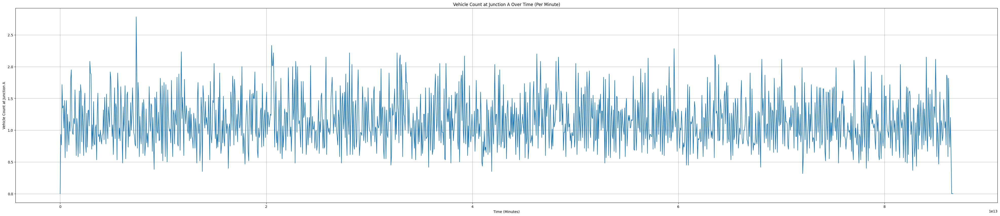

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the CSV file
df = pd.read_csv("/content/traffic_data.csv")

# Ensure 'Time' is in seconds and convert it to a pandas datetime format
df["Time"] = pd.to_timedelta(df["Time"], unit="s")

# Resample data per minute (taking the mean for averaging)
df_minute = df.resample("1T", on="Time").mean()

# Plot the downsampled data
plt.figure(figsize=(50, 10))  # Adjust figure size
plt.plot(df_minute.index, df_minute["Vehicle Count at Junction A"])

# Add labels and title
plt.xlabel("Time (Minutes)")
plt.ylabel("Vehicle Count at Junction A")
plt.title("Vehicle Count at Junction A Over Time (Per Minute)")

# Show the grid
plt.grid(True)

# Display the plot
plt.show()


<ipython-input-29-42470fe6ee63>:11: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  df_minute = df.resample("1T", on="Time").mean()


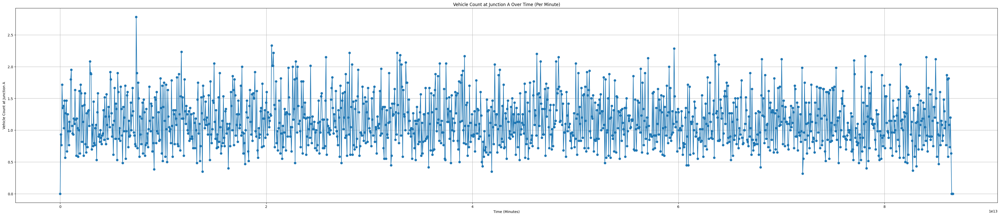

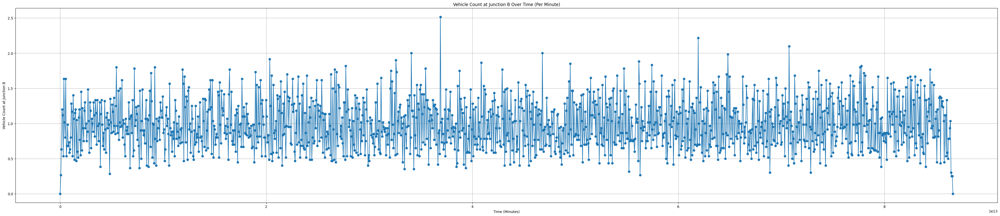

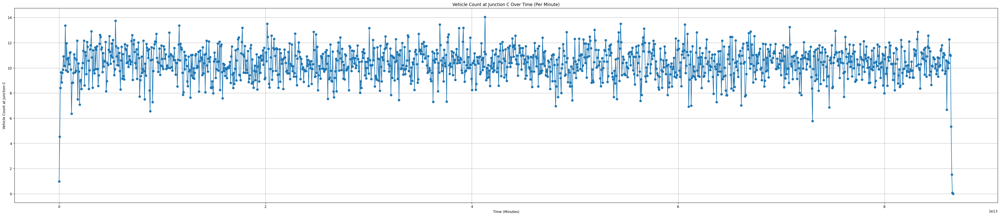

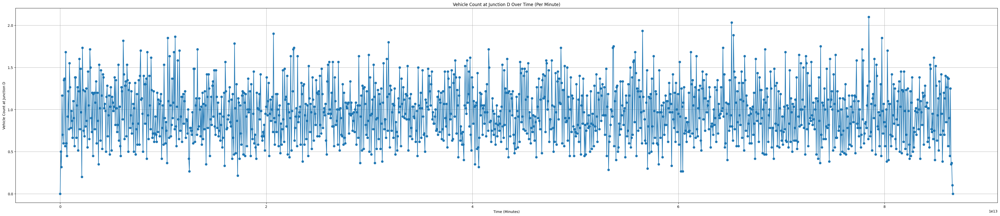

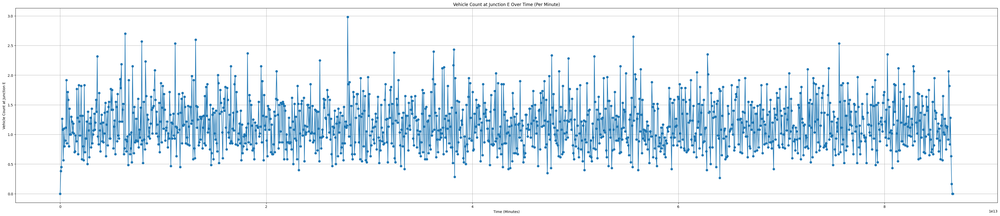

...

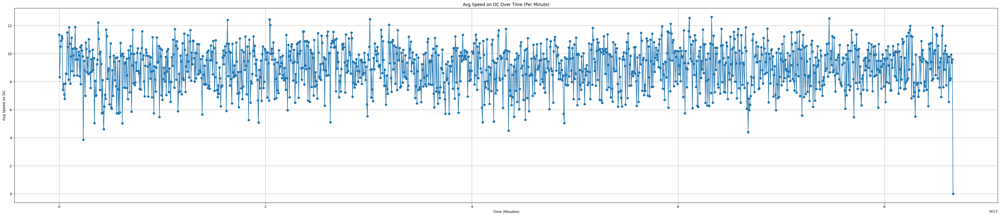

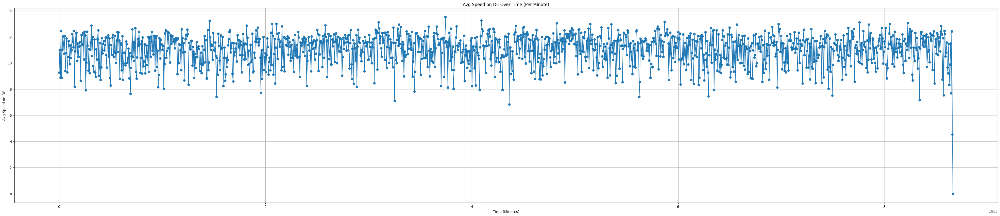

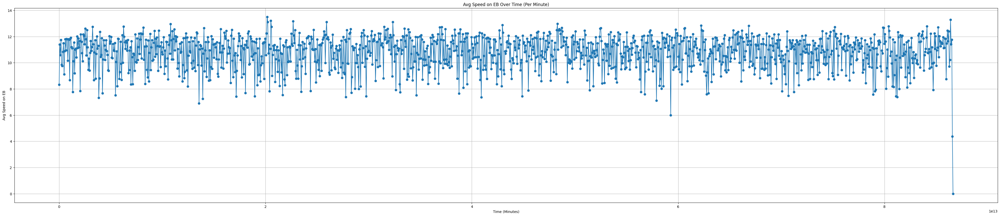

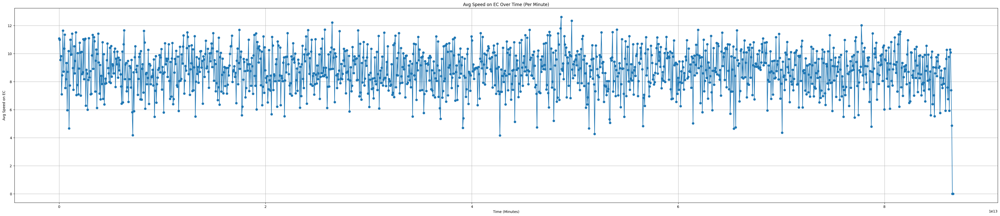

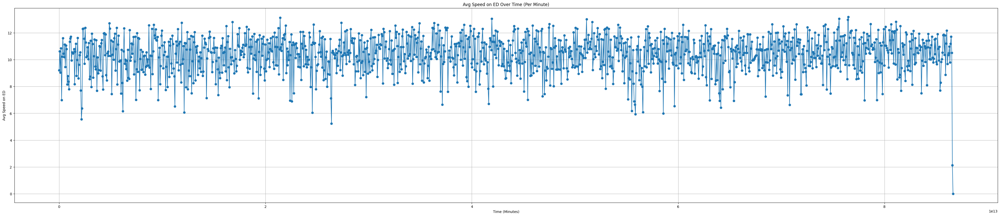

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the CSV file
df = pd.read_csv("/content/traffic_data.csv")

# Ensure 'Time' is in seconds and convert it to a pandas datetime format
df["Time"] = pd.to_timedelta(df["Time"], unit="s")

# Resample data per minute (taking the mean)
df_minute = df.resample("1T", on="Time").mean()

# Set figure size
figsize = (50, 10)

# Loop through all columns except "Time"
for column in df_minute.columns:
    plt.figure(figsize=figsize)
    plt.plot(df_minute.index, df_minute[column])

    # Add labels and title
    plt.xlabel("Time (Minutes)")
    plt.ylabel(column)
    plt.title(f"{column} Over Time (Per Minute)")

    # Show the grid
    plt.grid(True)

    # Display the plot
    plt.show()


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the CSV file
df = pd.read_csv("/content/traffic_data.csv")

# Ensure 'Time' is in seconds and convert it to a pandas datetime format
df["Time"] = pd.to_timedelta(df["Time"], unit="s")

# Resample data per minute (taking the mean)
df_minute = df.resample("1T", on="Time").mean()

# Number of plots
num_cols = len(df_minute.columns)

# Create a single figure with multiple subplots
fig, axes = plt.subplots(num_cols, 1, figsize=(50, 10 * num_cols), sharex=True)

# Loop through all columns and plot in subplots
for i, column in enumerate(df_minute.columns):
    axes[i].plot(df_minute.index, df_minute[column])
    axes[i].set_ylabel(column)
    axes[i].set_title(f"{column} Over Time (Per Minute)")
    axes[i].grid(True)

# Set common X label
axes[-1].set_xlabel("Time (Minutes)")

# Save the combined figure
plt.savefig("/content/all_plots.png", bbox_inches="tight", dpi=300)

# Show the combined plot
plt.show()


<ipython-input-30-3b9919f01fef>:11: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  df_minute = df.resample("1T", on="Time").mean()


In [ ]:
!sumo --version


/bin/bash: line 1: sumo: command not found


In [ ]:
!sudo apt-get remove --purge sumo sumo-tools sumo-doc
!sudo apt-get autoremove


Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following packages were automatically installed and are no longer required:
  binfmt-support fastjar fonts-roboto-unhinted jarwrapper libcoin80c
  libcollada-dom2.5-dp0 libfox-1.6-0 libgdal30 libglu1-mesa libjs-openlayers
  liblua5.2-0 libopenscenegraph161 libopenthreads21 libpoppler-glib8 libproj22
  libspatialindex-c6 libspatialindex-dev libspatialindex6 python3-certifi
  python3-numpy python3-pyproj python3-rtree
Use 'sudo apt autoremove' to remove them.
The following packages will be REMOVED:
  sumo* sumo-doc* sumo-tools*
0 upgraded, 0 newly installed, 3 to remove and 31 not upgraded.
After this operation, 599 MB disk space will be freed.
(Reading database ... 131155 files and directories currently installed.)
Removing sumo (1.22.0-1) ...
Removing sumo-doc (1.22.0-1) ...
Removing sumo-tools (1.22.0-1) ...
Processing triggers for mailcap (3.70+nmu1ubuntu1) ...
Processing triggers for

In [ ]:

!sudo add-apt-repository ppa:sumo/stable
!sudo apt-get update


Repository: 'deb https://ppa.launchpadcontent.net/sumo/stable/ubuntu/ jammy main'
Description:
SUMO is a highly portable, microscopic traffic simulation package designed to handle large road networks. SUMO is open source, licensed under the EPLv2.
More info: https://launchpad.net/~sumo/+archive/ubuntu/stable
Adding repository.
Press [ENTER] to continue or Ctrl-c to cancel.
Found existing deb entry in /etc/apt/sources.list.d/sumo-ubuntu-stable-jammy.list
Adding deb entry to /etc/apt/sources.list.d/sumo-ubuntu-stable-jammy.list
Found existing deb-src entry in /etc/apt/sources.list.d/sumo-ubuntu-stable-jammy.list
Adding disabled deb-src entry to /etc/apt/sources.list.d/sumo-ubuntu-stable-jammy.list
Adding key to /etc/apt/trusted.gpg.d/sumo-ubuntu-stable.gpg with fingerprint 7604B28616B7E70EC0E6D840C32412BB1ADB414B
Hit:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease
Hit:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Hit:3 http

In [ ]:
!sudo apt-get install sumo sumo-tools sumo-doc


Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  binfmt-support fastjar jarwrapper libfox-1.6-0 libgdal30 libglu1-mesa
  libjs-openlayers libproj22 libspatialindex-c6 libspatialindex-dev
  libspatialindex6 python3-certifi python3-numpy python3-pyproj python3-rtree
Suggested packages:
  python-numpy-doc python3-pytest
The following NEW packages will be installed:
  binfmt-support fastjar jarwrapper libfox-1.6-0 libgdal30 libglu1-mesa
  libjs-openlayers libproj22 libspatialindex-c6 libspatialindex-dev
  libspatialindex6 python3-certifi python3-numpy python3-pyproj python3-rtree
  sumo sumo-doc sumo-tools
0 upgraded, 18 newly installed, 0 to remove and 31 not upgraded.
Need to get 142 MB of archives.
After this operation, 666 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/main amd64 binfmt-support amd64 2.2.1-2 [55.8 kB]
Get:2 https://ppa.launchpad

In [ ]:
!sumo --version


Eclipse SUMO sumo Version 1.22.0
 Build features: Linux-6.8.0-51-generic x86_64 GNU 11.4.0 Release FMI Proj GUI Intl SWIG Eigen GDAL GL2PS
 Copyright (C) 2001-2025 German Aerospace Center (DLR) and others; https://sumo.dlr.de

Eclipse SUMO sumo Version 1.22.0 is part of SUMO.
This program and the accompanying materials
are made available under the terms of the Eclipse Public License v2.0
which accompanies this distribution, and is available at
http://www.eclipse.org/legal/epl-v20.html
This program may also be made available under the following Secondary
Licenses when the conditions for such availability set forth in the Eclipse
Public License 2.0 are satisfied: GNU General Public License, version 2
or later which is available at
https://www.gnu.org/licenses/old-licenses/gpl-2.0-standalone.html
SPDX-License-Identifier: EPL-2.0 OR GPL-2.0-or-later


In [8]:
import pandas as pd
import matplotlib.pyplot as plt

file = "/content/traffic_data_dyn.csv"
data= pd.read_csv(file)

data.tail()


,Time,Vehicle Count at Junction A,Vehicle Count at Junction B,Vehicle Count at Junction C,Vehicle Count at Junction D,Vehicle Count at Junction E,Avg Speed on AB,Avg Speed on BC,Avg Speed on CA,Avg Speed on CD,Avg Speed on ED,Avg Speed on DA
86630,86631.0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,13.716305
86631,86632.0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,12.823331
86632,86633.0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,13.493811
86633,86634.0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,13.758053
86634,86635.0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.000000


<ipython-input-9-068c6fdba2f6>:11: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  df_minute = df.resample("1T", on="Time").mean()


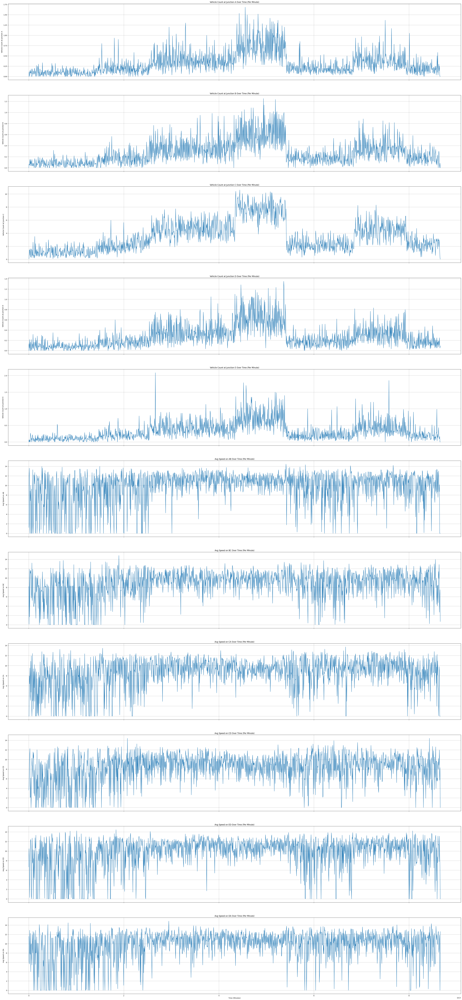

In [9]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the CSV file
df = pd.read_csv("/content/traffic_data_dyn.csv")

# Ensure 'Time' is in seconds and convert it to a pandas datetime format
df["Time"] = pd.to_timedelta(df["Time"], unit="s")

# Resample data per minute (taking the mean)
df_minute = df.resample("1T", on="Time").mean()

# Number of plots
num_cols = len(df_minute.columns)

# Create a single figure with multiple subplots
fig, axes = plt.subplots(num_cols, 1, figsize=(50, 10 * num_cols), sharex=True)

# Loop through all columns and plot in subplots
for i, column in enumerate(df_minute.columns):
    axes[i].plot(df_minute.index, df_minute[column])
    axes[i].set_ylabel(column)
    axes[i].set_title(f"{column} Over Time (Per Minute)")
    axes[i].grid(True)

# Set common X label
axes[-1].set_xlabel("Time (Minutes)")

# Save the combined figure
plt.savefig("/content/all_plots.png", bbox_inches="tight", dpi=300)

# Show the combined plot
plt.show()


<ipython-input-10-6446ae76b21b>:11: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  df_minute = df.resample("5T", on="Time").mean()


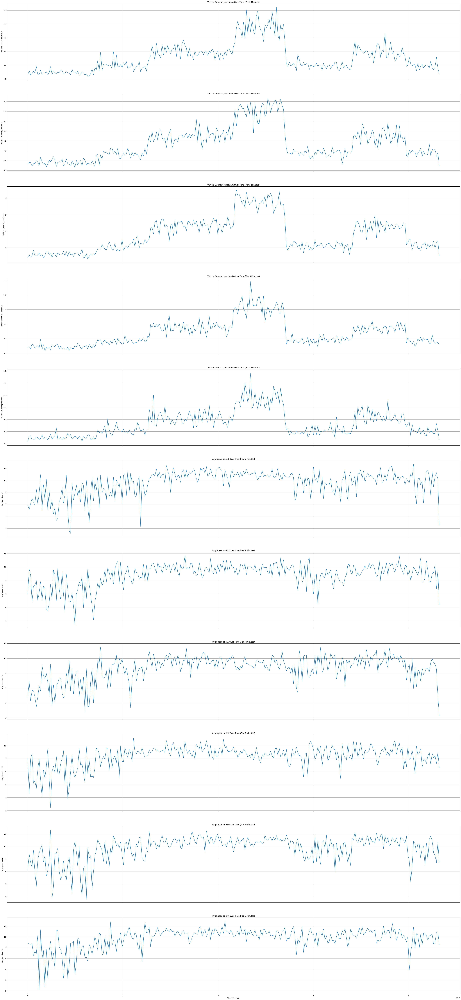

In [10]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the CSV file
df = pd.read_csv("/content/traffic_data_dyn.csv")

# Ensure 'Time' is in seconds and convert it to a pandas datetime format
df["Time"] = pd.to_timedelta(df["Time"], unit="s")

# Resample data per minute (taking the mean)
df_minute = df.resample("5T", on="Time").mean()

# Number of plots
num_cols = len(df_minute.columns)

# Create a single figure with multiple subplots
fig, axes = plt.subplots(num_cols, 1, figsize=(50, 10 * num_cols), sharex=True)

# Loop through all columns and plot in subplots
for i, column in enumerate(df_minute.columns):
    axes[i].plot(df_minute.index, df_minute[column])
    axes[i].set_ylabel(column)
    axes[i].set_title(f"{column} Over Time (Per 5 Minutes)")
    axes[i].grid(True)

# Set common X label
axes[-1].set_xlabel("Time (Minutes)")

# Save the combined figure
plt.savefig("/content/all_plots.png", bbox_inches="tight", dpi=300)

# Show the combined plot
plt.show()
